# -----------------Visualizing Drought by US County------------------
# ------------------------------------------------------------------------------------


This data is provided for open use at [this kaggle page.](https://www.kaggle.com/us-drought-monitor/united-states-droughts-by-county/home)
The purpose of this project is to gain experience with Geospatial analysis and visualization libraries.

I was first inspired to work on this after seeing kaggle user [@andresionek's](https://www.kaggle.com/andresionek) project analyzing Brazilian E-commerce. Check it out. It's very stylish. I also was able to mimick features from [Holoview's County Mapping Example](https://raw.githubusercontent.com/ioam/holoviews/master/examples/gallery/demos/matplotlib/texas_choropleth_example.ipynb) and Mat Leonard's [Udacity Medium Post](https://medium.com/udacity/creating-map-animations-with-python-97e24040f17b) on moving maps. 

# Importing Libraries
First, let's import the plotting library Holoviews, as well as some color schemes, display abilities. We'll also import cv2 for combining our images and we'll import widgets for an interactive section. 

In [2]:
#plotting
import holoviews as hv
import holoviews.plotting.mpl
hv.extension('matplotlib')
from colorcet import fire, rainbow
from IPython.display import display_png
#video generation
import cv2
import os
%output fig='png'
#widget creation
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

Then let's import pandas and do a quick fix to stop matplotlib's deprecation warnings

In [3]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

# Importing and Cleaning Data
We'll take the polygons of US counties from the bokeh library, and we'll import the dataset from the USDM. Let's look at the USDM data. Don't worry about seeing the county data yet because you'll see it a few sections down.

In [4]:
from bokeh.sampledata.us_counties import data as counties
drought=pd.read_csv("C:/Kaggle/Droughts/us-droughts.csv.zip",compression="zip", encoding='latin1')
drought.head()

,releaseDate,FIPS,county,state,NONE,D0,D1,D2,D3,D4,validStart,validEnd,domStatisticFormatID
0,2000-11-07,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-11-07,2000-11-13,1
1,2000-10-31,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-31,2000-11-06,1
2,2000-10-24,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-24,2000-10-30,1
3,2000-10-17,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-17,2000-10-23,1
4,2000-10-10,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-10,2000-10-16,1


First note that county polygons were imported as a dict where the key is the county code (FIPS code).

FIPS codes are tuples in one dataset but integers (third column) in the other... so we must make the county codes uniform. 

In [119]:
for i in range(1,3):
    for key in counties.keys():
        if(type(key)!=int):
            joinedkey=1000*key[0]+key[1]
            counties[joinedkey]=counties[key]
            del counties[key]


The reporting on drought level is cumulative so I simply add them together to get a statistic. Description of drought statistics are at [this kaggle page](https://www.kaggle.com/us-drought-monitor/united-states-droughts-by-county/home) for the curious.

In [8]:
drought["drought_level"]=drought["D0"]/100+drought["D1"]/100+drought["D2"]/100+drought["D3"]/100+drought["D4"]/100
drought.head()

,releaseDate,FIPS,county,state,NONE,D0,D1,D2,D3,D4,validStart,validEnd,domStatisticFormatID,drought_level
0,2000-11-07,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-11-07,2000-11-13,1,0.0
1,2000-10-31,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-31,2000-11-06,1,0.0
2,2000-10-24,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-24,2000-10-30,1,0.0
3,2000-10-17,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-17,2000-10-23,1,0.0
4,2000-10-10,2013,Aleutians East Borough,AK,100.0,0.0,0.0,0.0,0.0,0.0,2000-10-10,2000-10-16,1,0.0


We consolidate the entries by month and use the highest week's drought index. Doing so gives us a Pandas Series which we name drought_monthly. Let's take a look at what the head of drought_monthly looks like.

In [9]:
drought_monthly=drought[["FIPS","validEnd","drought_level"]]
drought_monthly.validEnd=pd.to_datetime(drought_monthly.validEnd)
drought_monthly.validEnd=drought_monthly.validEnd.dt.to_period("M")
drought_monthly=drought_monthly.groupby(["FIPS","validEnd"]).drought_level.max()
drought_monthly.head()

FIPS  validEnd
1001  2000-01     2.0000
      2000-02     1.0000
      2000-03     1.5019
      2000-04     1.2818
      2000-05     2.0391
Name: drought_level, dtype: float64

We convert counties into a Pandas Dataframe so we can add the drought index of a certain month as a column.

In [11]:
counties_drought=pd.DataFrame.from_dict(counties, orient='index')
for year in range(2010,2016):
    for month in range(1,13):
        if month<10:
            month="0"+str(month)
        date=str(year)+"-"+str(month)
        counties_drought[date]=0
        for cid in counties_drought.index:
            if (cid,date) in drought_monthly:
                counties_drought.loc[cid,date]=drought_monthly[(cid,date)]

In [82]:
counties_drought.head()

,name,detailed name,state,lats,lons,2010-01,2010-02,2010-03,2010-04,2010-05,...,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12
1001,Autauga,"Autauga County, Alabama",al,"[32.4757, 32.46599, 32.45054, 32.44245, 32.439...","[-86.41182, -86.41177, -86.41167, -86.41157, -...",0.0,0.0,0.0,0.1133,0.0900,...,1.000,1.0000,0.8692,0.9917,0.0000,0.0860,1.0000,1.0000,1.0000,0.0
1003,Baldwin,"Baldwin County, Alabama",al,"[30.28557, 30.21934, 30.21771, 30.21183, 30.20...","[-87.51203, -87.56704, -87.5741, -87.59954, -8...",0.0,0.0,0.0,0.0328,0.3527,...,2.000,1.3812,0.1498,0.0000,0.7975,1.0000,1.9985,2.5049,0.3168,0.0
1005,Barbour,"Barbour County, Alabama",al,"[32.02221, 32.02066, 32.0135, 32.00249, 31.996...","[-85.04884, -85.05367, -85.05381, -85.06454, -...",0.0,0.0,0.0,1.0000,1.0000,...,0.941,1.9930,1.0000,0.0000,1.0000,1.0000,0.1486,0.1478,0.1478,0.0
1007,Bibb,"Bibb County, Alabama",al,"[33.13143, 33.13086, 33.15133, 33.18184, 33.18...","[-87.23637, -87.21582, -87.19914, -87.19907, -...",0.0,0.0,0.0,0.0000,0.0000,...,0.000,0.0000,0.0000,0.3299,0.4274,1.0455,1.0000,1.3865,1.3865,0.0
1009,Blount,"Blount County, Alabama",al,"[33.949, 33.95621, 33.9629, 33.97324, 33.99538...","[-86.8332, -86.81779, -86.79248, -86.7719, -86...",0.0,0.0,0.0,0.0028,0.0000,...,1.000,0.0468,0.0000,1.0000,1.9936,1.9637,0.7604,0.8315,0.4240,0.0


## Making a still map
1) We are going to make a moving/video map for the continental US later. But let's get a still map first. The dataset has all states and territories, so let's drop some rows.     
2) A Holoviews [Polygons Object](http://holoviews.org/reference/elements/matplotlib/Polygons.html) doesn't accept a Pandas Dataframe. We'll input a list with internal dictionaries to comply with the software. Printing a single entry can show well the structure of our list.   
3) Let's define our time frame as this decade. Since the data cuts off in 2016 we'll use all of 2010 through 2015, inclusive. We'll store the date strings in a list so we can iterate through them later and access list elements. 

In [117]:
#1 
counties_drought_continental=counties_drought[~counties_drought["state"].isin(['hi', 'ha','ak','pr','gu','mp','as','vi'])]
#2
counties_drought_dict=counties_drought_continental.to_dict("index")
counties_drought_list = [dict(county)for cid, county in counties_drought_dict.items()]
#3
dates_list=[]
for year in range(2010,2016):
    for month in range(1,13):
        if month<10:
            month="0"+str(month)
        date=str(year)+"-"+str(month)
        dates_list.append(date)

Now we plot the thing! If you run this yourself it might take 20 seconds. The rainbow color palette goes from blue to red which makes it a nice visualization tool for drought. We'll plot January, 2010 first.

:Polygons   [lons,lats]   (2010-02)
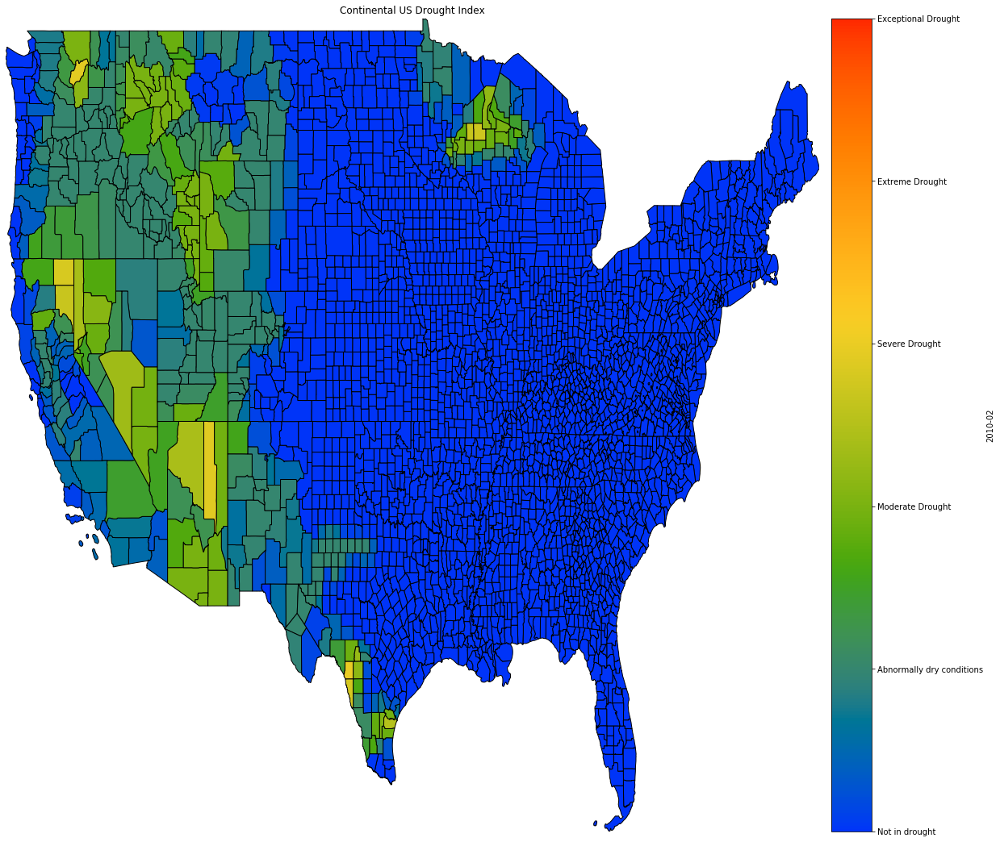

In [118]:
cbar_tick_labels=[(0,'Not in drought'),(1,'Abnormally dry conditions'),(2,'Moderate Drought'),(3,'Severe Drought'),(4,'Extreme Drought'),(5,'Exceptional Drought')]
polygons = hv.Polygons(counties_drought_list, ['lons', 'lats'], vdims=hv.Dimension(dates_list[1], range=(0, 5)), label="Continental US Drought Index")
polygons.options(logz=False, xaxis=None, yaxis=None, cbar_ticks=cbar_tick_labels,
                   show_grid=False, show_frame=False, colorbar=True, color_index=dates_list[1],
                   fig_size=500, edgecolor='black', cmap=list(rainbow))


# Letting the User Choose a map
Let the user specify an input for a map to be made. We'll import some widget libraries to help with that.

In [51]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

In [113]:
month_input=widgets.IntSlider(
    value=7,
    min=1,
    max=12,
    step=1,
    description='Month:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)
year_input=widgets.IntSlider(
    value=2012,
    min=2010,
    max=2015,
    step=1,
    description='Year:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)
state_abbrevs=counties_drought[~counties_drought["state"].isin(['ha','pr','gu','mp','as','vi'])].state.unique()
state_input=widgets.Dropdown(
    options=state_abbrevs,
    value='ca',
    description='State:',
    disabled=False,
    continuous_update=False
)
display(month_input)
display(year_input)
display(state_input)

IntSlider(value=7, continuous_update=False, description='Month:', max=12, min=1)

IntSlider(value=2012, continuous_update=False, description='Year:', max=2015, min=2010)

Dropdown(description='State:', index=4, options=('al', 'ak', 'az', 'ar', 'ca', 'co', 'ct', 'de', 'dc', 'fl', '…

Now, running the following code we can quickly generate a snapshot map for any state!

ca2012-07


:Polygons   [lons,lats]   (2012-07)
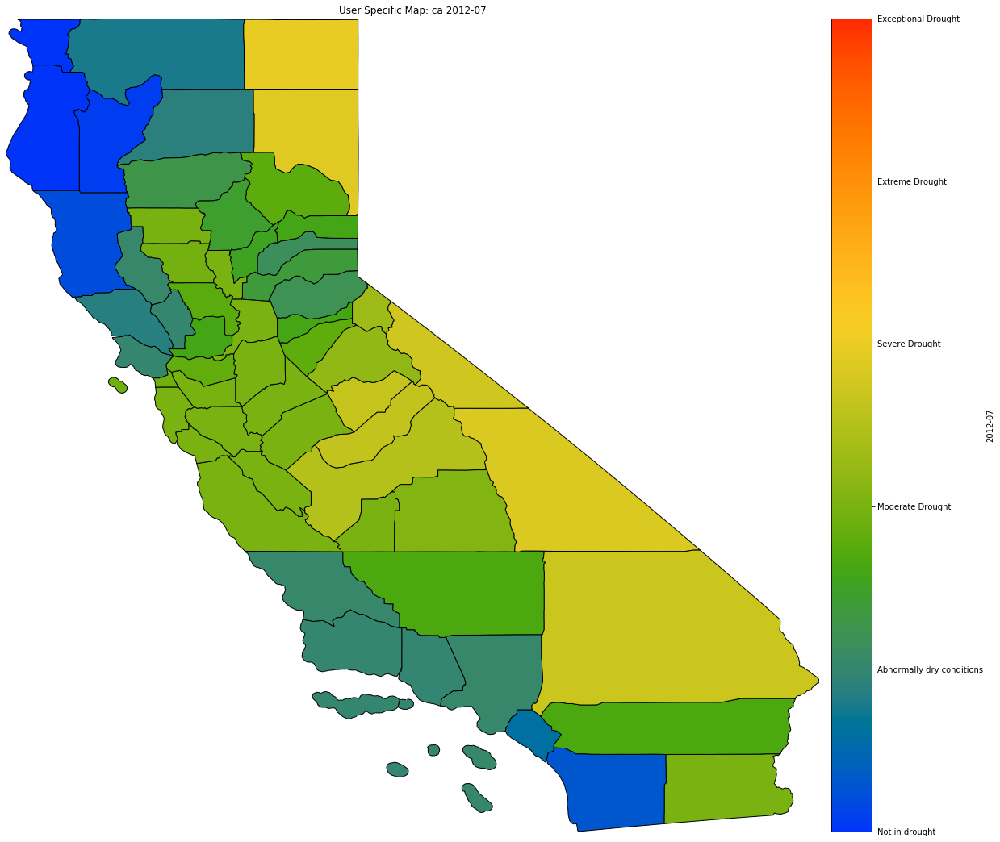

In [114]:
if month_input.value<10:
    month_input_str="0"+str(month_input.value)
    date=str(year_input.value)+"-"+str(month_input_str)
else:
    date=str(year_input.value)+"-"+str(month_input.value)
counties_drought_user_input=counties_drought[counties_drought["state"].isin([state_input.value])]
counties_drought_user_input.head()
counties_drought_user_dict=counties_drought_user_input.to_dict("index")
counties_drought_user_list = [dict(county)for cid, county in counties_drought_user_dict.items()]
cbar_tick_labels=[(0,'Not in drought'),(1,'Abnormally dry conditions'),(2,'Moderate Drought'),(3,'Severe Drought'),(4,'Extreme Drought'),(5,'Exceptional Drought')]
polygons = hv.Polygons(counties_drought_user_list, ['lons', 'lats'], vdims=hv.Dimension(date, range=(0, 5)), label="User Specific Map: "+state_input.value+" "+date)
polygons.options(logz=False, xaxis=None, yaxis=None, cbar_ticks=cbar_tick_labels,
                   show_grid=False, show_frame=False, colorbar=True, color_index=date,
                   fig_size=500, edgecolor='black', cmap=list(rainbow))

# Making a moving map
We'll loop throught the data, changing the dimension used to color the image (vdims), and rendering the images as pngs. 

In [18]:
plots={}
renderer = hv.plotting.mpl.MPLRenderer.instance(dpi=120)
for date in dates_list:
    polygons.vdims=[hv.Dimension(date, range=(0, 5))]
    plots[date]=polygons.options(logz=False, xaxis=None, yaxis=None, cbar_ticks=cbar_tick_labels,
                   show_grid=False, show_frame=False, colorbar=True, color_index=date,
                   fig_size=500, edgecolor='black', cmap=list(rainbow))
for date in dates_list:
    path="C:/Kaggle/Droughts/pngs/"+date
    renderer.save(plots[date],path ,fmt='png')

2010-01
2010-02
2010-03
2010-04
2010-05
2010-06
2010-07
2010-08
2010-09
2010-10
2010-11
2010-12
2011-01
2011-02
2011-03
2011-04
2011-05
2011-06
2011-07
2011-08
2011-09
2011-10
2011-11
2011-12
2012-01
2012-02
2012-03
2012-04
2012-05
2012-06
2012-07
2012-08
2012-09
2012-10
2012-11
2012-12
2013-01
2013-02
2013-03
2013-04
2013-05
2013-06
2013-07
2013-08
2013-09
2013-10
2013-11
2013-12
2014-01
2014-02
2014-03
2014-04
2014-05
2014-06
2014-07
2014-08
2014-09
2014-10
2014-11
2014-12
2015-01
2015-02
2015-03
2015-04
2015-05
2015-06
2015-07
2015-08
2015-09
2015-10
2015-11
2015-12


We put them together as a video saved locally below.

In [33]:
dir_path = "C:/Kaggle/Droughts/pngs/"
for f in os.listdir("C:/Kaggle/Droughts/pngs/"):
    if f.endswith("png"):
        images.append(f)
image_path = os.path.join("C:/Kaggle/Droughts/pngs/", images[0])
frame = cv2.imread(image_path)
cv2.imshow('video',frame)
height, width, channels = frame.shape

In [45]:
fourcc = cv2.VideoWriter_fourcc(*'mp4v') 
out = cv2.VideoWriter("C:/Kaggle/Droughts/pngs/vid.mp4", fourcc, 5.0, (width, height))

In [46]:
dir_path = "C:/Kaggle/Droughts/pngs/"
for image in images:

    image_path = os.path.join(dir_path, image)
    frame = cv2.imread(image_path)

    out.write(frame) 

    cv2.imshow('video',frame)
    if (cv2.waitKey(1) & 0xFF) == ord('q'): 
        break
out.release()
cv2.destroyAllWindows()

# We have video!
To play it in this notebook, run the code block below and the video will load. If it loads too large in the window, click the maximize button in the bottom right corner of the video to see a full screen version. 

The video should also have been saved locally.

In [1]:
import base64
import io
from IPython.display import HTML

video = io.open('C:/Kaggle/Droughts/pngs/vid.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))